Tubes Pembelajaran mesin lanjut

Nama   : Farhan Abdullah Yunus

NIM    : 1301213365

Fungsi : F14

Range  : [-50,100]

Metode : Firefly Algorithm dan RAO3

# Fungsi objektif

Shekel’s Foxholes benchmark function

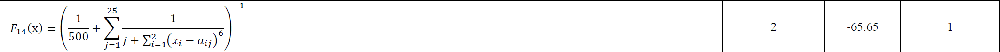



Gambar benchmark function untuk range -50,100

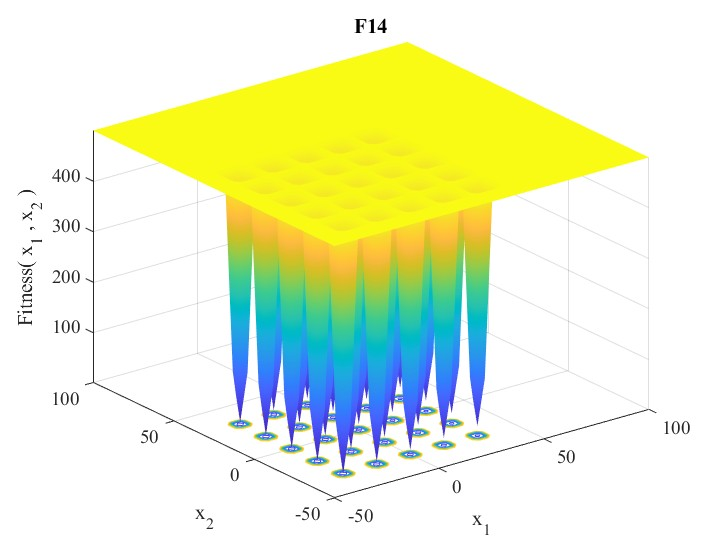


# Import Module


In [ ]:
import numpy as np
import math
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import animation,cm
from IPython.display import HTML
import random

# *Firefly Algorithm*

Firefly algorithm atau algoritma kunang-kunang merupakan algoritma yang terinspirasi dari alam yaitu kunang-kunang dan digunakan untuk optimasi (Yang, 2009)

Aturan Firefly (Yang, 2009)

1. Semua kunang kunang *unisex*
2. Daya tarik (attractiveness) kunang-kunang bersifat proposional terhadap intensitas cahaya (light intensity) yang dimilikinya.
3. Intensitas cahaya kunang-kunang ditentukan oleh fungsi objektif.

1) kunang-kunang tertarik satu sama lain tanpa mempedulikan gender

2) Kunang-kunang yang memiliki cahaya kurang terang akan tertarik dan bergerak ke kunang-kunang bercahaya lebih terang. Jika tidak ada kunang-kunang bercahaya lebih terang dari dirinya, maka kunang-kunang tersebut akan bergerak secara acak.

3) Untuk masalah maksimasi, intensitas cahaya proposional dengan nilai fungsi objektif. Bentuk lain dari intensitas cahaya dapat didefinisikan dengan cara yang mirip dengan fungsi fitness pada algoritma genetika.

*Firefly Algorithm*  (Yang, 2009)

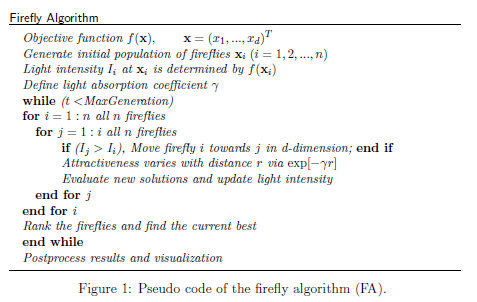



Cara kerja *firefly algorithm*
1. Tentukan fungsi objektif yang digunakan
2. Inisialisasi populasi kunang-kunang
3. Intensitas cahaya (fitness) kunang kunang ditentukan menggunakan fungsi objektif
4. Inisialisasi γ
5. Iterasi i..n kunang-kunang
6. Iterasi j..n Kunang-kunang
7. Jika intensitas kunang-kunang j lebih baik dari i
8. kunang kunang i bergerak ke kunang kunang j
9. Evaluasi kunang-kunang dan perbarui intensitas
10. Tentukan kunang-kunang dengan intensitas terbaik
11. ulangi langkah 5 - 10 sebanyak jumlah generasi
12. Visualisasi algoritma


Rumus Pergerakan kunang-kunang

1) *Distance*

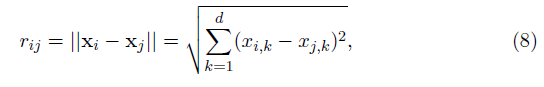

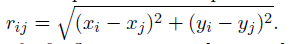

2) *Attractiveness*

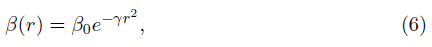

3) *Movement*

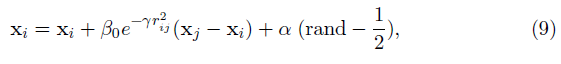


Kodingan

In [ ]:
class firefly:
  def __init__(self, alpha, beta, gamma,range1,range2,n_size,d,MaxGeneration,factor,random_walk): # inisialisasi
    # Initialize all the parameters (α,β,γ,n)
    self.alpha = alpha
    self.beta = beta
    self.gamma = gamma
    self.n = range1 + (range2 - range1) * np.random.rand(n_size, d) # Initialize randomly a population of n fireflies

    # Initialize for firefly algorithm
    self.MaxGeneration = MaxGeneration # Max generation
    self.range1 = range1 # Lower bound
    self.range2 = range2 # Upper bound
    self.n_size = n_size # Population size
    self.d = d
    self.fitness = np.apply_along_axis(self.F14, 1, self.n) # Evaluate the fitness of initial population using Shekel’s Foxholes benchmark function
    self.factor = factor
    self.random_walk = random_walk

  def F14(self,x): # Shekel’s Foxholes benchmark function
    aS = np.array([[-32, -16, 0, 16, 32, -32, -16, 0, 16, 32, -32, -16, 0, 16, 32, -32, -16, 0, 16, 32, -32, -16, 0, 16, 32],
                  [-32, -32, -32, -32, -32, -16, -16, -16, -16, -16, 0, 0, 0, 0, 0, 16, 16, 16, 16, 16, 32, 32, 32, 32, 32]])

    bS = np.zeros(25)
    for j in range(25):
      bS[j] = np.sum((x - aS[:, j])**6)

    o = (1/500 + np.sum(1 / (np.arange(1, 26) + bS)))**-1
    return o

  def run(self):
    # turn off auto show plot
    plt.ioff()
    # Create a meshgrid of points
    x = np.linspace(self.range1, self.range2, 100)
    y = np.linspace(self.range1, self.range2, 100)
    X, Y = np.meshgrid(x, y)


    # Vectorize function
    F14_vectorized = np.vectorize(lambda x1, x2: self.F14(np.array([x1, x2])))

    # Evaluate the function at each point in the meshgrid
    Z = F14_vectorized(X, Y)

    # Create plot
    fig, ax = plt.subplots()

    # Create contour
    contour = ax.contourf(X, Y, Z, cmap='viridis')

    # Set the labels and title
    ax.set_xlabel('x1')
    ax.set_ylabel('x2')
    ax.set_title('Contour Plot of F14 with Fireflies')


    # Scatter plot for fireflies
    scatter = ax.scatter([i[0] for i in self.n],[i[1] for i in self.n], c=self.fitness, cmap='coolwarm', edgecolor='k', s=10)

    # Add a separate colorbar for the scatter plot representing fitness
    cbar_scatter = fig.colorbar(scatter, ax=ax, orientation='vertical')
    cbar_scatter.set_label('Fitness')

    def animate(data): # Animate using data from firefly algorithm
      # Split data
      n, fitness,generation = data
      # Update scatter plot
      scatter.set_offsets(n)
      scatter.set_array(fitness)
      scatter.set_clim(vmin=min(fitness), vmax=max(fitness))
      ax.set_title(f"Generation {generation+1}")
      return scatter
    # Animate Firefly algorithm
    ani = animation.FuncAnimation(fig=fig, func=animate, frames=self.step(), interval=100,cache_frame_data=False)
    return ani

  def step(self): # Firefly algorithm
    t = 0 # initialize generation
    firefliestemp = []
    firefliesfittemp = []

    yield self.n,self.fitness,t # Save data for plotting
    # Iterate generation
    while (t < self.MaxGeneration):
      # Iterate each firefly in population
      for i in range(self.n_size):
        # Checkpoint if solution not accepted
        firefliestemp = self.n[i]
        firefliesfittemp = self.fitness[i]
        # Iterate each firefly in population
        for j in range(self.n_size):
          # Firefly i brightest
          if self.fitness[i] == max(self.fitness):
            self.n[i] += -self.random_walk + (self.random_walk + self.random_walk) * np.random.rand(2) # Random move in specified range
            self.n[i] = np.maximum(self.range1, self.n[i]) # Force into range1 if n[1] below minimum range
            self.n[i] = np.minimum(self.range2, self.n[i]) # Force into range2 if n[1] above max range
            self.fitness[i] = self.F14(self.n[i]) # evaluate fitness of firefly i
            break
          # Firefly j is better/brighter than i
          if self.fitness[j] < self.fitness[i]:
            self.distance = math.sqrt(sum((self.n[i][k] - self.n[j][k])**2 for k in range(self.d))) # Distance
            self.attractiveness = self.beta * np.exp(-self.gamma * (self.distance**2)) # Attractiveness
            self.n[i] += self.attractiveness * (self.n[j] - self.n[i]) + self.alpha * (np.random.rand(2) - 0.5) # Move firefly i toward j
            self.n[i] = np.maximum(self.range1, self.n[i]) # Force into range1 if n[1] below minimum range
            self.n[i] = np.minimum(self.range2, self.n[i]) # Force into range2 if n[1] above max range
            self.fitness[i] = self.F14(self.n[i]) # evaluate fitness


        # Evaluate new solution and accept if better or same
        if self.fitness[i] <= firefliesfittemp: # accept solution
          yield self.n,self.fitness,t # Only accepted solution is animated, solution used is after firefly i finish comparing fitness
        else:
          self.n[i] = firefliestemp
          self.fitness[i] = firefliesfittemp

      # Update the best solution and fitness

      self.best_index = np.argmin(self.fitness)
      self.best_solution = self.n[self.best_index]
      self.best_fitness = self.fitness[self.best_index]

      # Display the best fitness value at each iteration
      print(f"Generation {t+1}, Best Fitness = {self.best_fitness}")
      # Update iteration (generation)
      t += 1
      # Reduce α (randomness strength by a factor)
      self.alpha /= self.factor


    # Display Best Solution and fitness
    print("-------------------")
    print("Optimization Results")
    print("-------------------")
    print("Best Solution:", self.best_solution)
    print("Best Fitness:", self.best_fitness)



Hyperparameter

alpha α (randomness strength) : mempengaruhi keserampangan pergerakan kunang kunang. Dikalikan dengan epsilon yaitu nilai random pada range (-0.5,0.5)

beta β : mempengaruhi *atractiveness* kunang kunang, mengalikan hasil eksponen gamma. beta yang di inisialisasi merupakan β0 atau *atractiveness* pada jarak r = 0.

gamma γ (light absorption coefficient) : mempengaruhi penyerapan cahaya semakin kecil maka *atractiveness* semakin besar

range1 : batas bawah *solution space*

range2 : batas atas *solution space*

n_size : ukuran populasi

d      : dimensi fungsi objektif

MaxGeneration : Generasi maksimum

factor : Mengurangi α berdasarkan faktor, digunakan untuk mengurangi keserampangan secara bertahap.

random_walk : Kunang-kunang bergerak secara acak jika tidak ada yang lebih terang dari dirinya. Jika 0 maka kunang-kunang tidak bergerak. Jika 1 kunang kunang bergerak dari posisinya dengan (-1,1) dan seterusnya

Setel hyperparameter



In [ ]:
alpha = 2 # α
beta = 2  # β
gamma = 0.05 # γ
range1 = -50 # lower bound
range2 = 100 # upper bound
n_size = 30 # population size
d = 2 # function dimension
MaxGeneration = 200 # Max generation
factor = 1 # Reduce α by a factor
random_walk = 3 # Random walk
Kunang_Kunang = firefly(alpha, beta, gamma,range1,range2,n_size,d,MaxGeneration,factor,random_walk)
Firefly_ani = Kunang_Kunang.run()

Jalankan *firefly algorithm*

In [ ]:
matplotlib.rcParams['animation.embed_limit'] = 10000
# Save the animation as HTML
html_video = Firefly_ani.to_jshtml()

Generation 1, Best Fitness = 308.96431223900083
Generation 2, Best Fitness = 308.96431223900083
Generation 3, Best Fitness = 308.96431223900083
Generation 4, Best Fitness = 246.760339269662
Generation 5, Best Fitness = 232.031354801794
Generation 6, Best Fitness = 8.522328022319737
Generation 7, Best Fitness = 7.878255600067999
Generation 8, Best Fitness = 7.878255600067999
Generation 9, Best Fitness = 7.877185837791989
Generation 10, Best Fitness = 7.877185837791989
Generation 11, Best Fitness = 7.874007440444102
Generation 12, Best Fitness = 7.874007440444102
Generation 13, Best Fitness = 7.874007440444102
Generation 14, Best Fitness = 7.874007440444102
Generation 15, Best Fitness = 7.874007440444102
Generation 16, Best Fitness = 7.874007440444102
Generation 17, Best Fitness = 6.230178909416469
Generation 18, Best Fitness = 6.230178909416469
Generation 19, Best Fitness = 6.230178909416469
Generation 20, Best Fitness = 6.230178909416469
Generation 21, Best Fitness = 6.230178909416469


Tampilkan Animasi

In [ ]:
HTML(html_video)

Analisis


Digunakan alpha sebesar 2 untuk menambah pergerakan acak dari kunang kunang. Beta sebesar 2 dan gamma sebesar 0.05 mengakibatkan daya tarik kunang kunang cukup besar dan kunang kunang tertarik satu sama lain jika jarak tidak terlalu jauh. Population size sebesar 30 berarti ada 30 kunang untuk mengeksplorasi solusi dan pencarian solusi dilakukan sebanyak 200 iterasi atau 200 generasi. Faktor yang digunakan adalah 1 berarti alpha dibagi 1 yang berarti nilai alpha tidak berubah pada tiap generasi. Digunakan random walk sebesar 3 supaya kunang kunang yang paling terang eksplorasi dalam range (-3,3) dari posisi.

Dari animasi yang ditampilkan kunang-kunang yang memiliki fitness terbaik berada pada kotak dalam plot. Kunang-kunang mendekati yang paling terang yang tidak terlalu jauh jika terlalu jauh daya tarik kecil dan kunang kunang bergerak secara acak. Solusi akhir yang terbaik adalah x1 = -31.94267948 dan x2 = -31.93637484 dengan fitness = 0.9980039367591559

# RAO3

RAO3 adalah algoritma tanpa metafora untuk menyelesaikan masalah optimasi yang dibatasi maupun tidak dibatasi (Rao, 2020). Algoritma RAO3 didasarkan solusi terbaik dan terburuk pada proses optimasi dan interaksi serampang antar solusi kandidat (Rao, 2020).

Flowchart RAO3

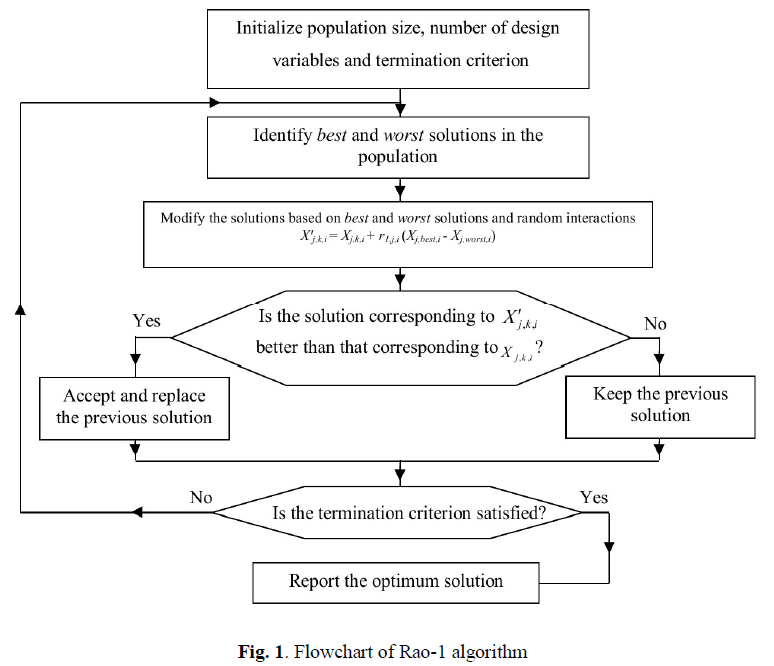

Cara kerja RAO3

1. Inisialisasi ukuran populasi, ukuran dimensi fungsi objektif dan kondisi terminasi.
3. Identifikasi solusi terbaik dan terburuk.
4. Modifikasi tiap solusi pada populasi dengan rumus rao3.
5. Jika solusi baru lebih baik ganti solusi lama atau sebaliknya.
6. Jika belum memenuhi kondisi terminasi ulangi langkah 3-5.
7. Jika memenuhi kondisi terminasi maka tampilkan solusi optimum.

Rumus solusi baru RAO3

image.png



j : Variabel dalam kandidat solusi, jika solusi = [x1,x2] maka variabel adalah x1 dan x2.

k : Kandidat solusi, jika fungsi objektif menerima inputan x1 dan x2 maka kandidat solusi adalah [x1,x2].

i : Iterasi atau perulangan sebelum algoritma mencapai kondisi terminasi, jika i = 2 berarti algoritma pada perulangan kedua.

r1 = nilai random saat iterasi i, tiap variabel memakai r1 yang berbeda

r2 = nilai random saat iterasi i, tiap variabel memakai r2 yang berbeda

worst : Kandidat solusi terburuk

best : Kandidat solusi terbaik

l = kandidat solusi yang dipilih secara random

“Xj,k,i or Xj,l,i” = jika Xj,k,i memiliki fitness yang lebih baik maka dikembalikan nilai Xj,k,i atau sebaliknya.

“Xj,l,i or Xj,k,i” = jika Xj,k,i memiliki fitness yang lebih baik maka dikembalikan nilai Xj,l,i atau sebaliknya.

Kodingan

In [ ]:
class RAO3:
  def __init__(self, range1, range2, n, d, MaxGeneration):
    self.x = range1 + (range2 - range1) * np.random.rand(n, d) # Initialize randomly a population
    self.fitness = [self.F14(i) for i in self.x] # Calculate fitness for all solution candidate
    self.range1 = range1
    self.range2 = range2
    self.x_updated = np.copy(self.x)
    self.n = n
    self.d = d
    self.MaxGeneration = MaxGeneration

  def F14(self,x): # Shekel’s Foxholes benchmark function
    aS = np.array([[-32, -16, 0, 16, 32, -32, -16, 0, 16, 32, -32, -16, 0, 16, 32, -32, -16, 0, 16, 32, -32, -16, 0, 16, 32],
                  [-32, -32, -32, -32, -32, -16, -16, -16, -16, -16, 0, 0, 0, 0, 0, 16, 16, 16, 16, 16, 32, 32, 32, 32, 32]])

    bS = np.zeros(25)
    for j in range(25):
      bS[j] = np.sum((x - aS[:, j])**6)

    o = (1/500 + np.sum(1 / (np.arange(1, 26) + bS)))**-1
    return o

  def compare1(self,k,l,j):
    if self.F14(self.x[k]) < self.F14(self.x[l]):
      return self.x[k][j]
    else:
      return self.x[l][j]
  def compare2(self,k,l,j):
    if self.F14(self.x[k]) > self.F14(self.x[l]):
      return self.x[k][j]
    else:
      return self.x[l][j]

  def run(self):
    # turn off auto show plot
    plt.ioff()
    # Create a meshgrid of points
    x = np.linspace(self.range1, self.range2, 100)
    y = np.linspace(self.range1, self.range2, 100)
    X, Y = np.meshgrid(x, y)


    # Vectorize function
    F14_vectorized = np.vectorize(lambda x1, x2: self.F14(np.array([x1, x2])))

    # Evaluate the function at each point in the meshgrid
    Z = F14_vectorized(X, Y)

    # Create plot
    fig, ax = plt.subplots()

    # Create contour
    contour = ax.contourf(X, Y, Z, cmap='viridis')

    # Set the labels and title
    ax.set_xlabel('x1')
    ax.set_ylabel('x2')
    ax.set_title('Contour Plot of F14 with Fireflies')


    # Scatter plot for fireflies
    scatter = ax.scatter([i[0] for i in self.x],[i[1] for i in self.x], c=self.fitness, cmap='coolwarm', edgecolor='k', s=10)

    # Add a separate colorbar for the scatter plot representing fitness
    cbar_scatter = fig.colorbar(scatter, ax=ax, orientation='vertical')
    cbar_scatter.set_label('Fitness')

    def animate(data): # Animate using data from firefly algorithm
      # Split data
      x, fitness,generation = data
      # Update scatter plot
      scatter.set_offsets(x)
      scatter.set_array(fitness)
      scatter.set_clim(vmin=min(fitness), vmax=max(fitness))
      ax.set_title(f"Generation {generation+1}")
      return scatter
    # Animate Firefly algorithm
    ani = animation.FuncAnimation(fig=fig, func=animate, frames=self.step(), interval=100,cache_frame_data=False)
    return ani

  def step(self):
    t = 0
    while (t < self.MaxGeneration):
      # Choose best and worst solution candidate
      self.best = np.argmin(self.fitness)
      self.worst = np.argmax(self.fitness)
      # Create random number in range (0,1) for each x1 and x2
      r1 = np.random.rand(self.d)
      r2 = np.random.rand(self.d)

      # create updated population using RAO3
      for k in range(self.n): # iterate k candidate
        l = random.randint(0, self.n - 1) # random number for l candidate
        for j in range(self.d): # iterate j variable
          self.x_updated[k][j] = self.x[k][j] + r1[j] * (self.x[self.best][j] - abs(self.x[self.worst][j])) + r2[j] * (abs(self.compare1(k,l,j)) - self.compare2(k,l,j)) # RAO3
        self.x_updated[k] = np.maximum(self.range1, self.x_updated[k]) # Force into range1 if n[1] below minimum range
        self.x_updated[k] = np.minimum(self.range2, self.x_updated[k]) # Force into range2 if n[1] above max range
      self.fitness_updated = [self.F14(i) for i in self.x_updated] # update fitness x_updated

      # Change solution in population with updated solution if better
      for k in range(self.n):
        if self.fitness_updated[k] <= self.fitness[k]: # if Updated solution better or same, Accept
          self.x[k] = self.x_updated[k]
          self.fitness[k] = self.fitness_updated[k]
          yield self.x,self.fitness,t
      # Update best solution
      self.best_index = np.argmin(self.fitness)
      self.best_solution = self.x[self.best_index]
      self.best_fitness = self.fitness[self.best_index]
      print(f"Generation {t+1}, Best Fitness = {self.best_fitness}")
      t += 1


    # Display Best Solution and fitness
    print("-------------------")
    print("Optimization Results")
    print("-------------------")
    print("Best Solution:", self.best_solution)
    print("Best Fitness:", self.best_fitness)

Parameter

range1 : batas bawah *solution space*

range2 : batas atas *solution space*

n : ukuran populasi

d : dimensi (ukuran variabel)

MaxGeneration = generasi maksimum atau kondisi terminasi



Setel hyperparameter

In [ ]:
range1 = -50
range2 = 100
n = 30
d = 2
MaxGeneration = 200
RAO_3 = RAO3(range1,range2,n,d,MaxGeneration)
RAO3_ani = RAO_3.run()

Jalankan RAO3

In [ ]:
# Save the animation as HTML
html_video2 = RAO3_ani.to_jshtml()

Generation 1, Best Fitness = 106.54209455348854
Generation 2, Best Fitness = 69.7211784717518
Generation 3, Best Fitness = 7.811439395238597
Generation 4, Best Fitness = 5.937798012458754
Generation 5, Best Fitness = 5.937798012458754
Generation 6, Best Fitness = 5.937798012458754
Generation 7, Best Fitness = 5.937798012458754
Generation 8, Best Fitness = 2.0237750232360057
Generation 9, Best Fitness = 2.0237750232360057
Generation 10, Best Fitness = 2.0237750232360057
Generation 11, Best Fitness = 2.0237750232360057
Generation 12, Best Fitness = 2.0237750232360057
Generation 13, Best Fitness = 2.0237750232360057
Generation 14, Best Fitness = 2.0237750232360057
Generation 15, Best Fitness = 2.0237750232360057
Generation 16, Best Fitness = 2.0237750232360057
Generation 17, Best Fitness = 2.0237750232360057
Generation 18, Best Fitness = 2.0237750232360057
Generation 19, Best Fitness = 2.0237750232360057
Generation 20, Best Fitness = 2.0237750232360057
Generation 21, Best Fitness = 2.0237

Tampilkan animasi

In [ ]:
HTML(html_video2)

Analisis

Digunakan 30 kandidat solusi dan 200 generasi untuk mencari kandidat solusi yang optimum. Pada animasi kandidat solusi bergerak ke solusi yang lebih baik sehingga untuk masing masing kandidat selalu bergerak kearah solusi yang lebih baik. Pada generasi akhir kandidat solusi berkumpul pada kotak di contour plot yang dimana solusi akhir yang terbaik adalah x1 = -31.96357808 dan x2 = -32.03207013 dengan fitness = 0.9980038420948468

# REFERENSI

Yang, X. S. (2009, October). Firefly algorithms for multimodal optimization. In International symposium on stochastic algorithms (pp. 169-178). Berlin, Heidelberg: Springer Berlin Heidelberg.

Rao, R.V. (2020). Rao algorithms: Three metaphor-less simple algorithms for solving optimization problems. International Journal of Industrial Engineering Computations.